<a href="https://colab.research.google.com/github/Pavionio/Fear_and_Hate_in_Taxi/blob/main/clean_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 19.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 48.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.1/16.1 MB 39.5 MB/s eta 0:00:00


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from matplotlib.ticker import MaxNLocator
import random
import geopy.distance as gp
import plotly.express as px
import math
import geopandas as gpd
from shapely.geometry import Point
import shapely
import json
from sklearn.ensemble import IsolationForest

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [ ]:
trip_duration = pd.read_csv('/content/gdrive/MyDrive/intensive/Project/nyc_taxi_trip_duration.csv')
weather = pd.read_csv('/content/gdrive/MyDrive/intensive/Project/nyc_2016_weather.csv')

# **Предобработка**

In [ ]:
weather['precipitation'] = weather['precipitation'].replace('T', 0).astype('float64')
weather['snow fall'] = weather['snow fall'].replace('T', 0).astype('float64')
weather['snow depth'] = weather['snow depth'].replace('T', 0).astype('float64')

In [ ]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 366 entries, 0 to 365
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   date                 366 non-null    object 
 1   maximum temperature  366 non-null    int64  
 2   minimum temperature  366 non-null    int64  
 3   average temperature  366 non-null    float64
 4   precipitation        366 non-null    float64
 5   snow fall            366 non-null    float64
 6   snow depth           366 non-null    float64
dtypes: float64(4), int64(2), object(1)
memory usage: 20.1+ KB


In [ ]:
def get_distance(p1, p2):
    # p1 и p2 - это кортежи из двух элементов - координаты точек
    radius = 6373.0

    lon1 = math.radians(p1[0])
    lat1 = math.radians(p1[1])
    lon2 = math.radians(p2[0])
    lat2 = math.radians(p2[1])

    d_lon = lon2 - lon1
    d_lat = lat2 - lat1

    a = math.sin(d_lat / 2) ** 2 + math.cos(lat1) * math.cos(lat2) * math.sin(d_lon / 2) ** 2
    c = 2 * math.atan2(a ** 0.5, (1 - a) ** 0.5)

    distance = radius * c
    return distance

In [ ]:
trip_duration['distance'] = trip_duration.apply(lambda x: get_distance((x.pickup_longitude, x.pickup_latitude), (x.dropoff_longitude, x.dropoff_latitude)), axis=1)
trip_duration['avg_speed'] = trip_duration.distance /  trip_duration.trip_duration * 3600 # км / ч

In [ ]:
df = pd.read_csv('/content/gdrive/MyDrive/intensive/Project/taxi_zones.csv')

# **Исключения выбросов**

In [ ]:
polygon = gpd.GeoDataFrame(geometry=shapely.wkt.loads(df.the_geom))

ls=[]

for _,row in trip_duration.iterrows():
  ls.append(polygon.contains(Point(row[5],row[6])).any() and polygon.contains(Point(row[7],row[8])).any())

In [ ]:
trip_duration[list(map(lambda x: not(x), ls))].to_csv('distace_anomalies.csv', index=False)
len(trip_duration[ls]), len(trip_duration)

In [ ]:
trip_duration=trip_duration.merge(weather, how='left', left_on=pd.to_datetime(trip_duration['pickup_datetime']).dt.date, right_on=pd.to_datetime(weather['date']).dt.date)[ls]

<ipython-input-10-bc23f86f56f2>:1: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  trip_duration=trip_duration.merge(weather, how='left', left_on=pd.to_datetime(trip_duration['pickup_datetime']).dt.date, right_on=pd.to_datetime(weather['date']).dt.date)


In [ ]:
trip_duration.to_csv('distace_filtered_duration_weather.csv', index=False)

In [ ]:
trip_duration.sort_values(by=['pickup_datetime','dropoff_datetime'],inplace=True)

In [ ]:
trip_duration = trip_duration[(trip_duration.passenger_count < 9) & (trip_duration.avg_speed != 0) & (trip_duration.passenger_count> 0)]

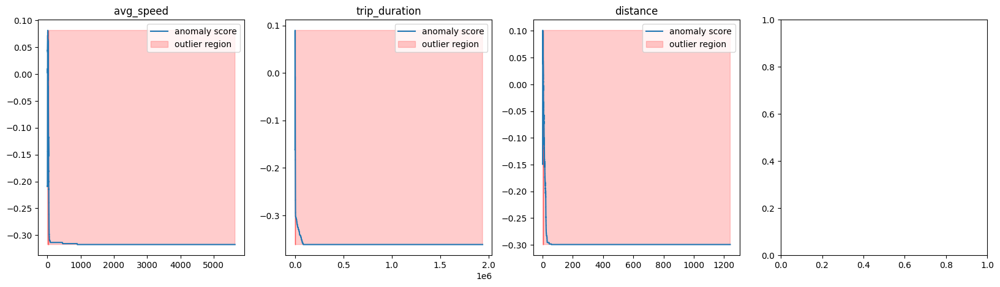

In [ ]:
from sklearn.ensemble import IsolationForest

columns = ['avg_speed','trip_duration','distance']
fig, axs = plt.subplots(1, 4, figsize=(20, 5), facecolor='w', edgecolor='k')
axs = axs.ravel()

for index, name in enumerate(columns):
    isolation_forest = IsolationForest(contamination='auto')
    isolation_forest.fit(trip_duration[name].values.reshape(-1,1))

    xx = np.linspace(trip_duration[name].min(), trip_duration[name].max(), len(trip_duration)).reshape(-1,1)
    anomaly_score = isolation_forest.decision_function(xx)
    outlier = isolation_forest.predict(xx)
    
    axs[index].plot(xx, anomaly_score, label='anomaly score')
    axs[index].fill_between(xx.T[0], np.min(anomaly_score), np.max(anomaly_score), 
                     where=outlier==-1, color='r', 
                     alpha=.2, label='outlier region')
    axs[index].legend()
    axs[index].set_title(name)

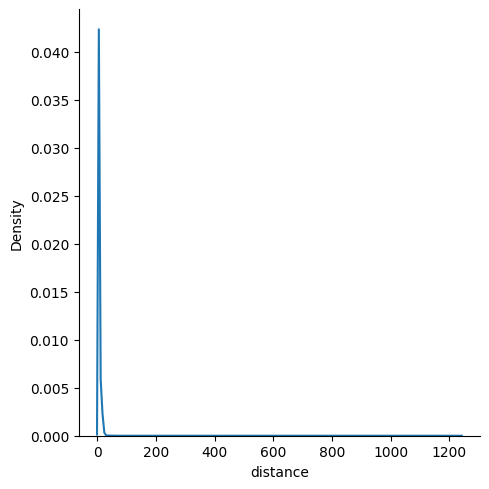

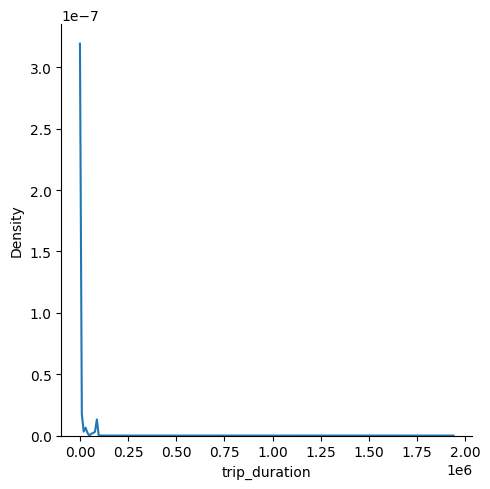

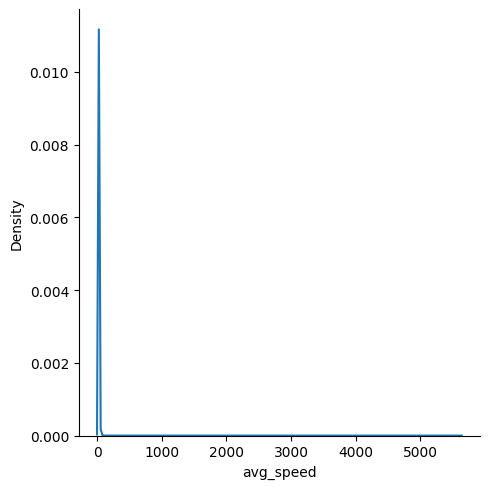

In [ ]:
trip_duration.sort_values(by=['distance'],inplace=True)
sns.displot(trip_duration.distance, kind="kde")
sns.displot(trip_duration.trip_duration, kind="kde")
sns.displot(trip_duration.avg_speed, kind="kde")

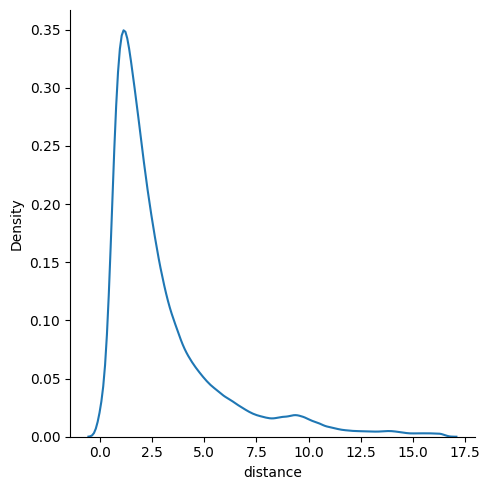

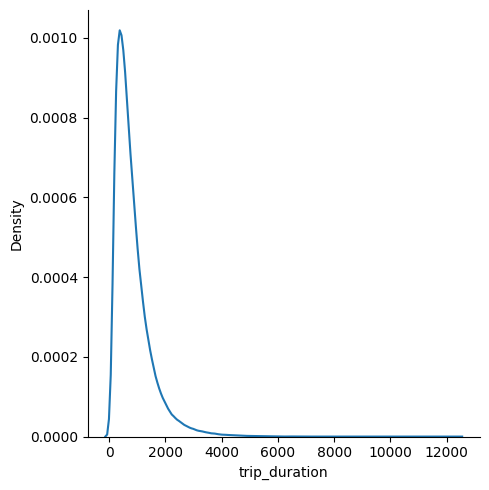

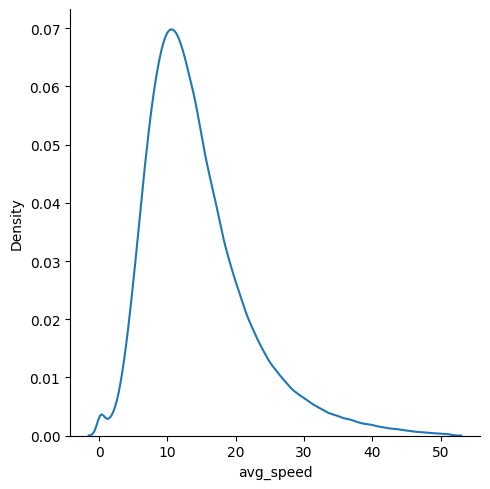

In [ ]:
def mask_f(col):
  return (col.mean() - 3*col.std()), (col.mean()  + 3*col.std())


mask = mask_f(trip_duration.distance)
sns.displot(trip_duration.distance[(trip_duration.distance > mask[0]) & (trip_duration.distance < mask[1])], kind="kde")
mask = mask_f(trip_duration.trip_duration)
sns.displot(trip_duration.trip_duration[(trip_duration.distance > mask[0]) & (trip_duration.trip_duration < mask[1])], kind="kde")
mask = mask_f(trip_duration.avg_speed)
sns.displot(trip_duration.avg_speed[(trip_duration.avg_speed > mask[0]) & (trip_duration.avg_speed < mask[1])], kind="kde")

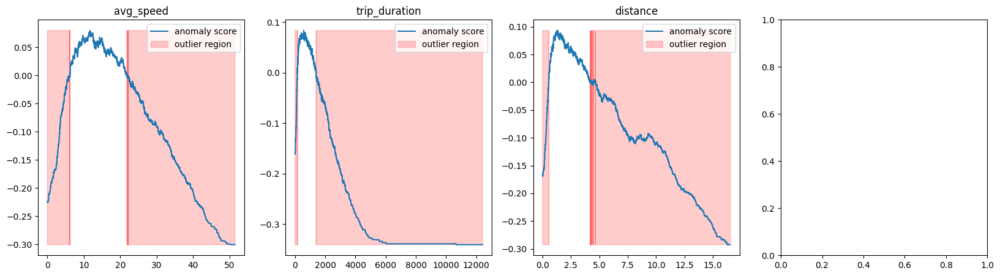

In [ ]:
from sklearn.ensemble import IsolationForest

columns = ['avg_speed','trip_duration','distance']
fig, axs = plt.subplots(1, 4, figsize=(20, 5), facecolor='w', edgecolor='k')
axs = axs.ravel()

for index, name in enumerate(columns):
    isolation_forest = IsolationForest(contamination='auto')
    mask = mask_f(trip_duration[name])
    col = trip_duration[name][(trip_duration[name] > mask[0]) & (trip_duration[name] < mask[1])]
    isolation_forest.fit(col.values.reshape(-1,1))

    xx = np.linspace(col.min(), col.max(), len(trip_duration)).reshape(-1,1)
    anomaly_score = isolation_forest.decision_function(xx)
    outlier = isolation_forest.predict(xx)
    
    axs[index].plot(xx, anomaly_score, label='anomaly score')
    axs[index].fill_between(xx.T[0], np.min(anomaly_score), np.max(anomaly_score), 
                     where=outlier==-1, color='r', 
                     alpha=.2, label='outlier region')
    axs[index].legend()
    axs[index].set_title(name)

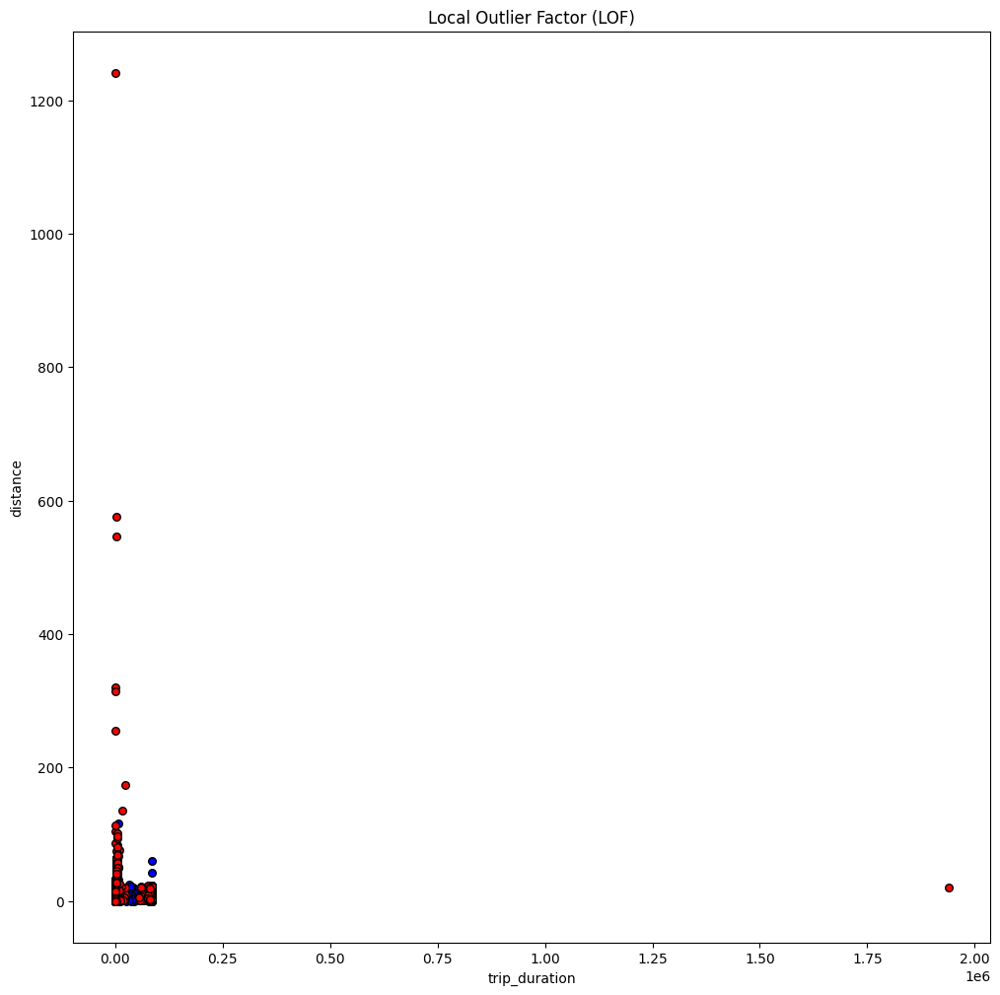

In [ ]:
from sklearn.neighbors import LocalOutlierFactor

LOF = LocalOutlierFactor(n_neighbors=50, contamination='auto')
x = trip_duration[['trip_duration','distance']].values
y_pred = LOF.fit_predict(x)

plt.figure(figsize=(12,12))


in_mask = [True if i == 1 else False for i in y_pred]
out_mask = [True if i == -1 else False for i in y_pred]

plt.title("Local Outlier Factor (LOF)")

a = plt.scatter(x[in_mask, 0], x[in_mask, 1], c = 'blue', edgecolor = 'k', s = 30)

b = plt.scatter(x[out_mask, 0], x[out_mask, 1], c = 'red', edgecolor = 'k', s = 30)
plt.axis('tight')
plt.xlabel('trip_duration');
plt.ylabel('distance');
plt.show()

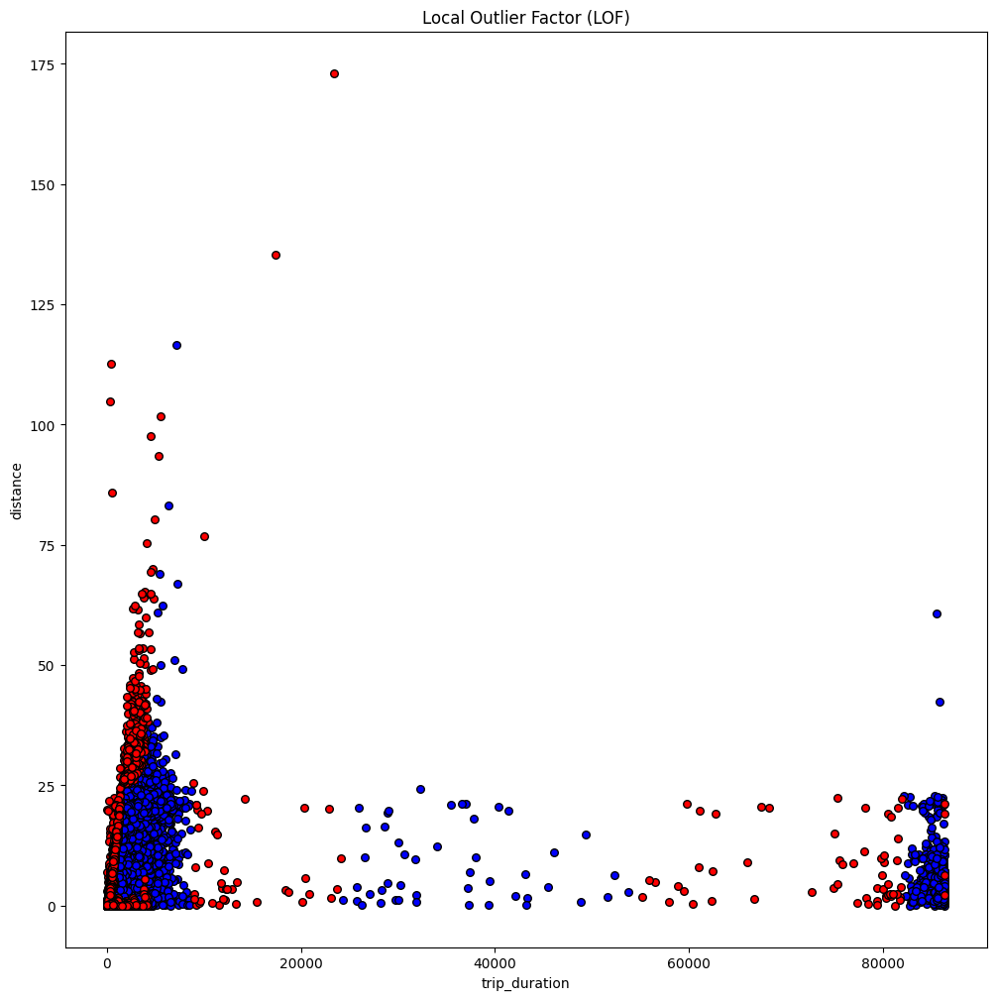

In [ ]:
from sklearn.neighbors import LocalOutlierFactor

LOF = LocalOutlierFactor(n_neighbors=50, contamination='auto')
x = trip_duration[['trip_duration','distance']][(trip_duration.distance < 190) & (trip_duration.trip_duration < 0.25 * 10**6)].values
y_pred = LOF.fit_predict(x)

plt.figure(figsize=(12,12))


in_mask = [True if i == 1 else False for i in y_pred]
out_mask = [True if i == -1 else False for i in y_pred]

plt.title("Local Outlier Factor (LOF)")

a = plt.scatter(x[in_mask, 0], x[in_mask, 1], c = 'blue', edgecolor = 'k', s = 30)

b = plt.scatter(x[out_mask, 0], x[out_mask, 1], c = 'red', edgecolor = 'k', s = 30)
plt.axis('tight')
plt.xlabel('trip_duration');
plt.ylabel('distance');
plt.show()

# **Зависимости поездок и погодных явлений**

In [ ]:
trip_duration['day'] = pd.to_datetime(trip_duration['pickup_datetime'].str.slice(stop=10))

In [ ]:
weather_analisys = trip_duration.groupby('day',as_index=False).agg({'id': 'count', 'maximum temperature' :'mean','minimum temperature' :'mean',
                                                     'average temperature' :'mean', 'precipitation': 'mean', 'snow fall' : 'mean', 'snow depth' : 'mean', 'distance': 'mean','avg_speed': 'mean'})
weather_analisys.rename(columns={"id": "taxi_count"},inplace=True)

<Axes: >

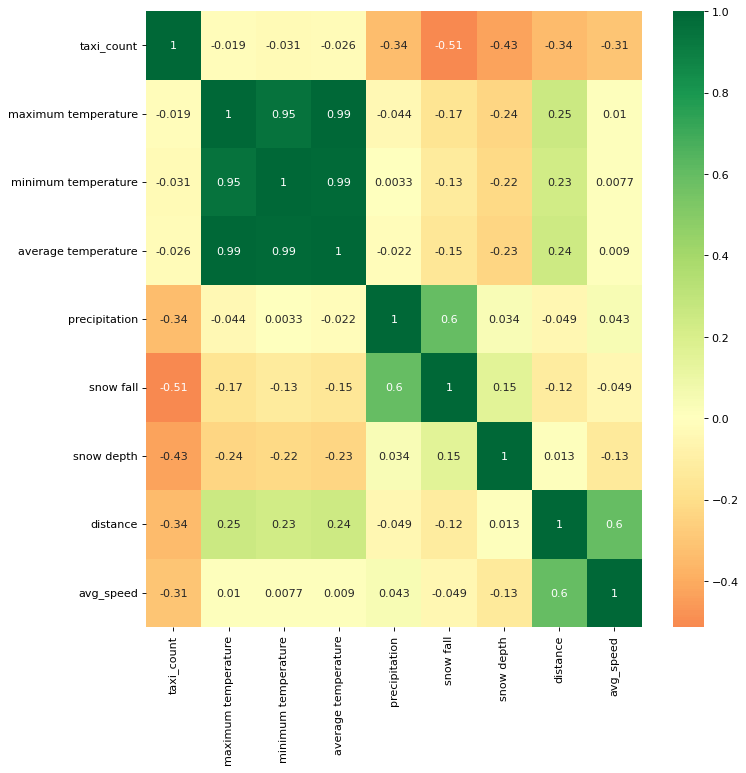

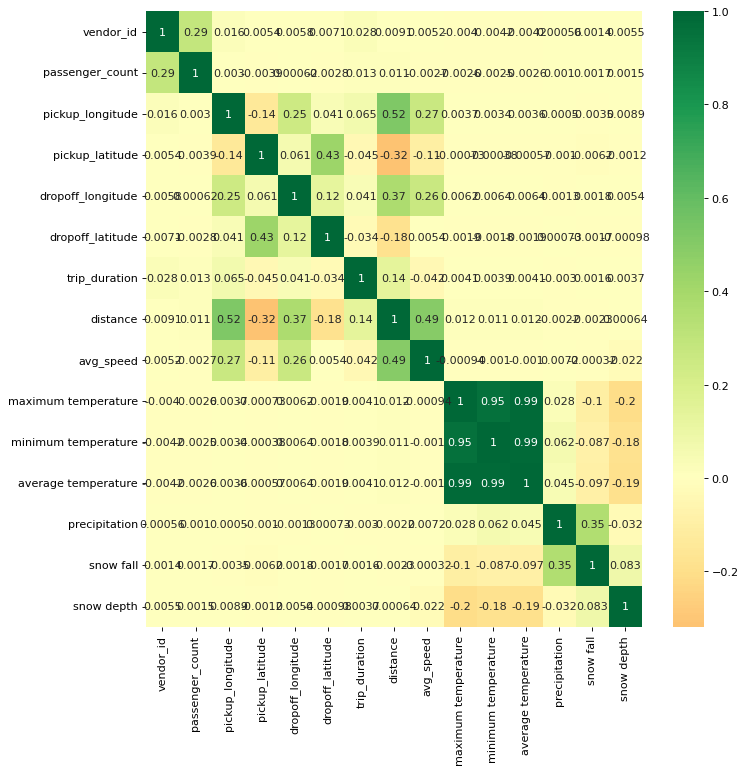

In [ ]:
corr = weather_analisys.corr()

plt.figure(figsize=(10,10), dpi= 80)
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, cmap='RdYlGn', center=0, annot=True)

corr = trip_duration.corr()

plt.figure(figsize=(10,10), dpi= 80)
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, cmap='RdYlGn', center=0, annot=True)

<Figure size 1000x1000 with 0 Axes>

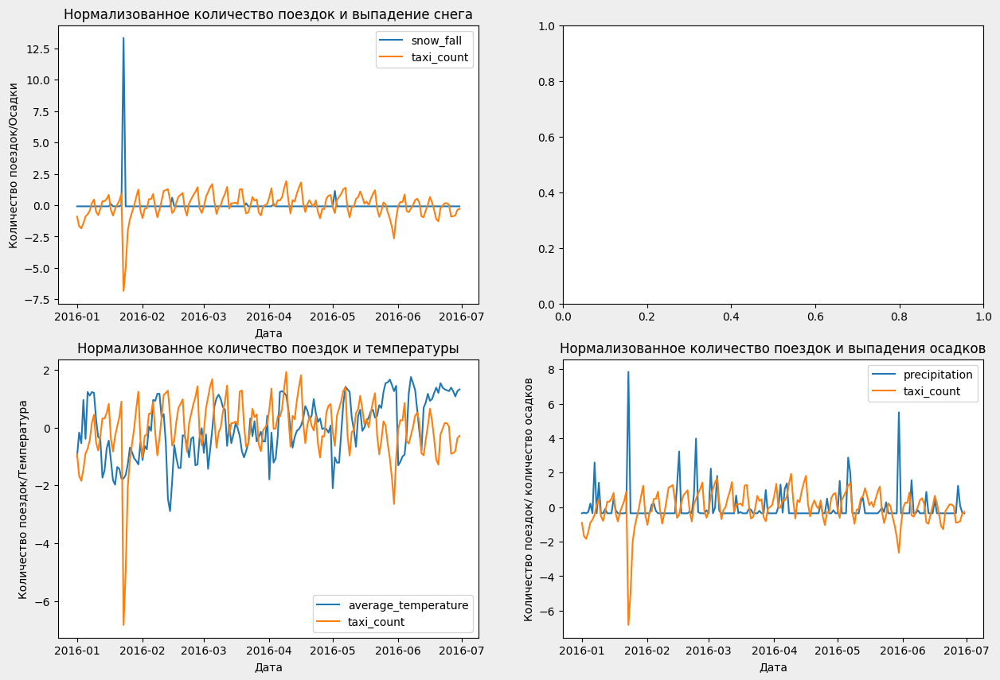

In [ ]:
fig = plt.figure(figsize=(10,10))

f, ax = plt.subplots(2,2)# краще выглядит 

f.set_size_inches(15, 10)     # размер 7 x 4 дюймов
f.set_facecolor('#eee')

snow_fall = (weather_analisys['snow fall'] - weather_analisys['snow fall'].mean()) / weather_analisys['snow fall'].std()
taxi_count= (weather_analisys['taxi_count'] - weather_analisys['taxi_count'].mean()) /  weather_analisys['taxi_count'].std()
average_temperature = (weather_analisys['average temperature'] - weather_analisys['average temperature'].mean()) / weather_analisys['average temperature'].std()
precipitation = (weather_analisys['precipitation'] - weather_analisys['precipitation'].mean()) / weather_analisys['precipitation'].std()

ax[0,0].plot(weather_analisys['day'], snow_fall,label = 'snow_fall')
ax[0,0].plot(weather_analisys['day'], taxi_count,label = 'taxi_count')
ax[0,0].set(title='Нормализованное количество поездок и выпадение снега',ylabel='Количество поездок/Осадки',xlabel='Дата')
ax[0,0].legend()



ax[1,0].plot(weather_analisys['day'], average_temperature,label = 'average_temperature')
ax[1,0].plot(weather_analisys['day'], taxi_count,label = 'taxi_count')
ax[1,0].set(title='Нормализованное количество поездок и температуры',ylabel='Количество поездок/Температура',xlabel='Дата')
ax[1,0].legend()

ax[1,1].plot(weather_analisys['day'], precipitation,label = 'precipitation')
ax[1,1].plot(weather_analisys['day'], taxi_count,label = 'taxi_count')
ax[1,1].set(title='Нормализованное количество поездок и выпадения осадков',ylabel='Количество поездок/ количество осадков',xlabel='Дата')
ax[1,1].legend()

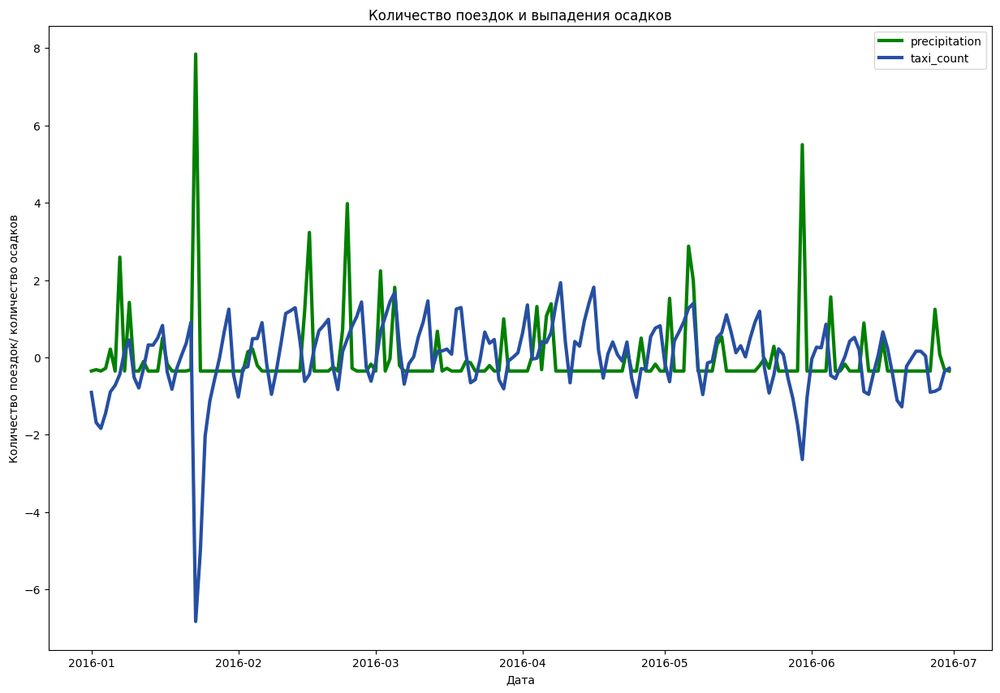

In [ ]:
f, ax = plt.subplots(1,1)
f.set_size_inches(15, 10) 

ax.plot(weather_analisys['day'], precipitation,label = 'precipitation', c='g',linewidth=3.0)
ax.plot(weather_analisys['day'], taxi_count,label = 'taxi_count', c='#264FA3',linewidth=3.0)
ax.set(title='Количество поездок и выпадения осадков',ylabel='Количество поездок/ количество осадков',xlabel='Дата')
ax.legend()

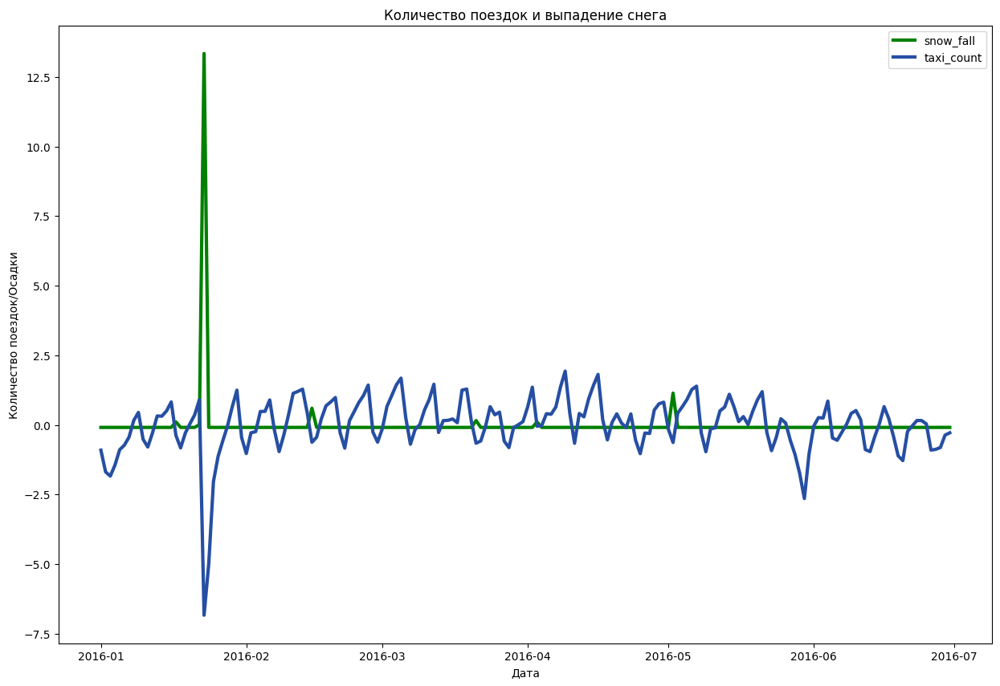

In [ ]:
f, ax = plt.subplots(1,1)

f.set_size_inches(15, 10)     # размер 7 x 4 дюймов
#f.set_facecolor('#eee')

ax.plot(weather_analisys['day'], snow_fall,label = 'snow_fall', c='g',linewidth=3.0)
ax.plot(weather_analisys['day'], taxi_count,label = 'taxi_count', c='#264FA3',linewidth=3.0)
ax.set(title='Количество поездок и выпадение снега',ylabel='Количество поездок/Осадки',xlabel='Дата')
ax.legend()

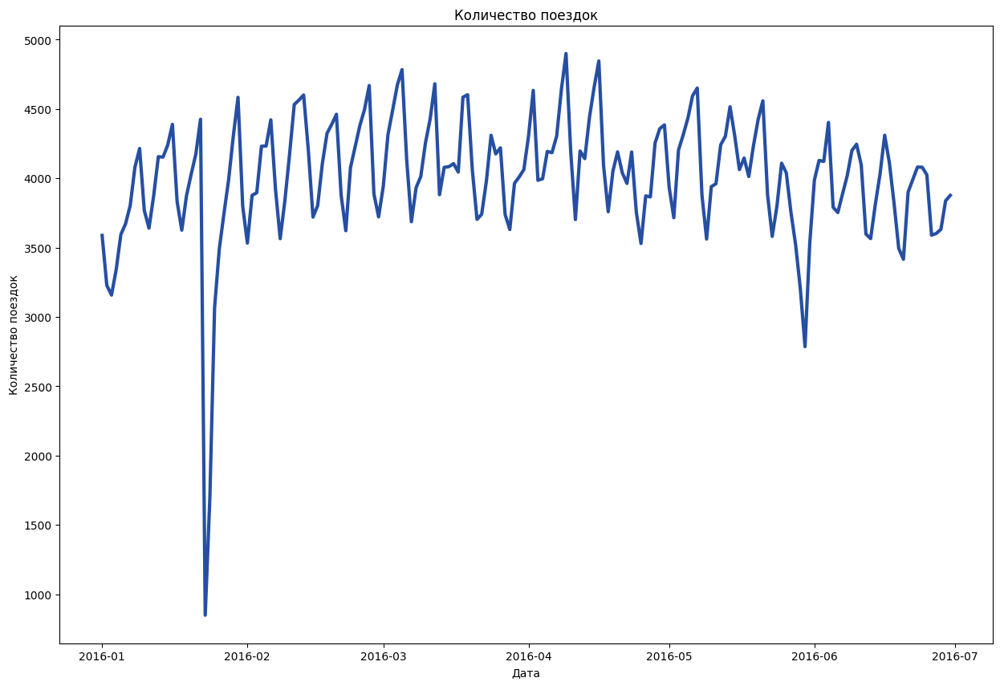

In [ ]:
f, ax = plt.subplots(1,1)
f.set_size_inches(15, 10) 
ax.set(title='Количество поездок',ylabel='Количество поездок',xlabel='Дата')
ax.plot(weather_analisys['day'], weather_analisys.taxi_count,label = 'taxi_count', c='#264FA3',linewidth=3.0)

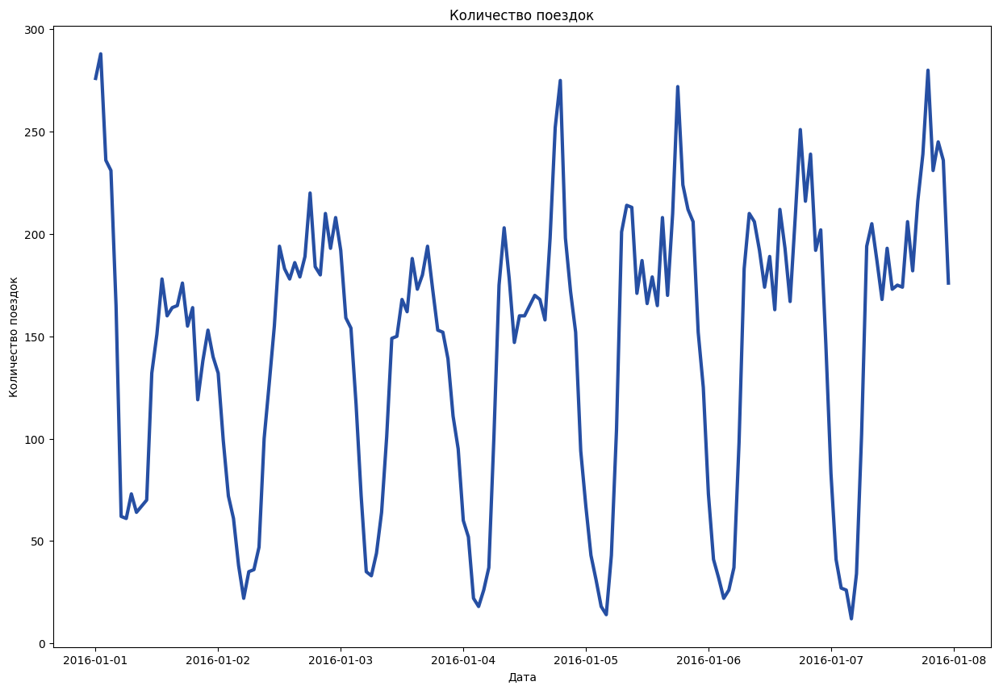

In [ ]:
trip_duration['hour'] = pd.to_datetime(trip_duration['pickup_datetime'].str.slice(stop=13))
weather_analisys = trip_duration.groupby('hour',as_index=False).agg({'id': 'count', 'maximum temperature' :'mean','minimum temperature' :'mean',
                                                     'average temperature' :'mean', 'precipitation': 'mean', 'snow fall' : 'mean', 'snow depth' : 'mean', 'distance': 'mean','avg_speed': 'mean'})
weather_analisys.rename(columns={"id": "taxi_count"},inplace=True)

f, ax = plt.subplots(1,1)
f.set_size_inches(15, 10) 
ax.set(title='Количество поездок',ylabel='Количество поездок',xlabel='Дата')
ax.plot(weather_analisys['hour'][:168], weather_analisys.taxi_count[:168],label = 'taxi_count', c='#264FA3',linewidth=3.0)

# **Временные ряды**

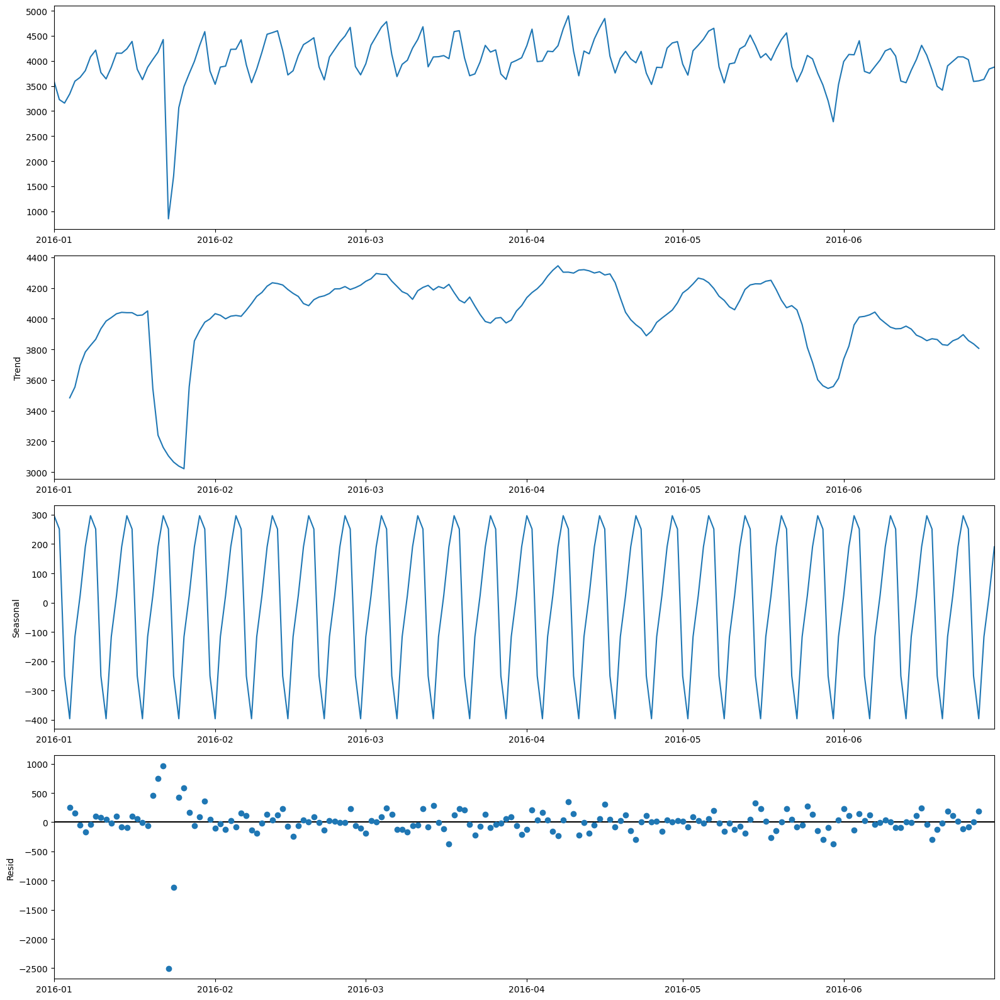

In [ ]:
import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib.pyplot import figure
data = weather_analisys.sort_values(by=['day']).loc[:, ('day','taxi_count')].set_index('day')
decomposition = seasonal_decompose(data, period=7)

fig = decomposition.plot()
fig.set_size_inches((16, 16))
# Tight layout to realign things
fig.tight_layout()
plt.show()

In [ ]:


# normal_seasonal = ((decomposition.seasonal- c.mean()) /  c.std()).to_numpy().reshape(-1,1)
# normal_taxi_count = ((weather_analisys['taxi_count'] - c.mean()) /  c.std()).to_numpy().reshape(-1,1)

clf = IsolationForest(random_state=0).fit(weather_analisys[['taxi_count']] )
pred = clf.predict(weather_analisys[['taxi_count']])


In [ ]:
weather_analisys['classification'] = pred

<Axes: xlabel='day'>

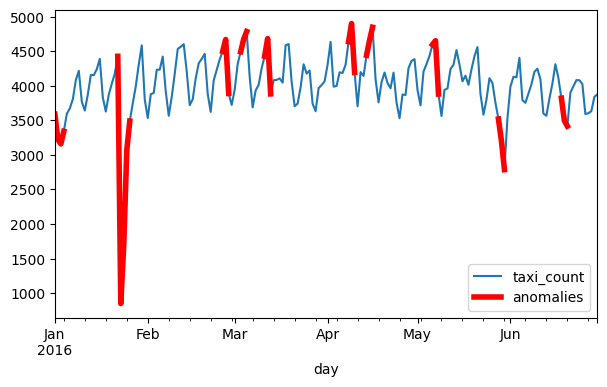

In [ ]:
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()


rt = True
i =1
while i < len(df_out)-1:
    if df_out.iloc[i+1,2] == -1:
        i+=2
        rt = False

    elif rt:
      df_out.iloc[i,1] = np.NaN
      i+=1
      rt= True
    else:
      rt= True
      i+=1

fig = plt.figure(figsize=(7,4))
ax = fig.add_subplot()

df_in.plot(x='day',y='taxi_count',ax=ax)
df_out.plot(x='day',y='taxi_count',ax=ax,c='red',linewidth= 4,label='anomalies')

<Axes: xlabel='day'>

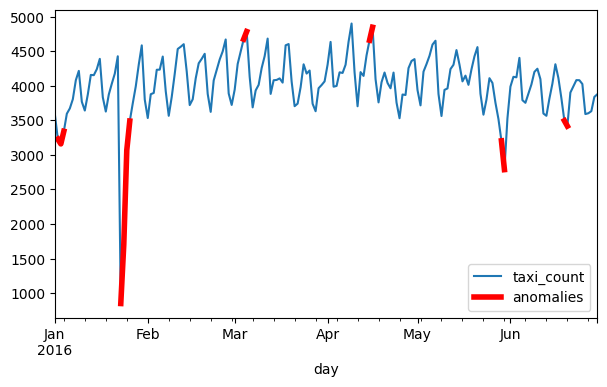

In [ ]:
clf = IsolationForest(random_state=0).fit(weather_analisys[['taxi_count']] )
weather_analisys['classification'] = pred
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()



df_out.loc[df_in.classification == 1,'taxi_count'] = np.NaN


fig = plt.figure(figsize=(7,4))
ax = fig.add_subplot()

df_in.plot(x='day',y='taxi_count',ax=ax)
df_out.plot(x='day',y='taxi_count',ax=ax,c='red',linewidth= 4,label='anomalies')

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


<Axes: xlabel='day', ylabel='taxi_count'>

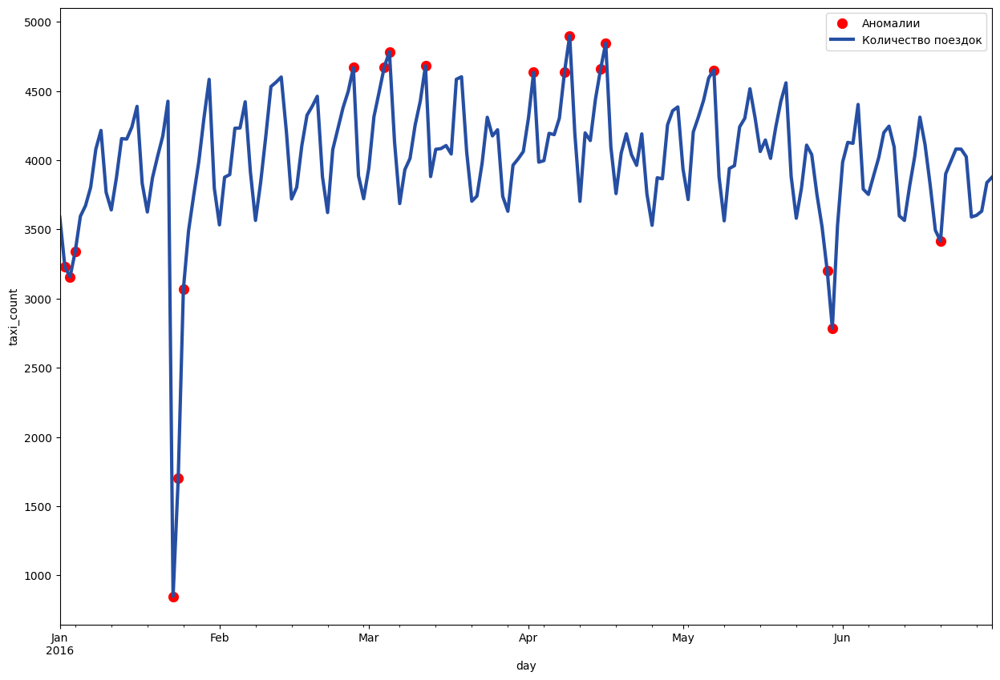

In [ ]:
clf = IsolationForest(n_estimators=5, max_samples='auto', contamination=float(0.1)).fit(weather_analisys[['taxi_count']] )
pred = clf.predict(weather_analisys[['taxi_count']])
weather_analisys['classification'] = pred
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()


df_out.loc[df_in.classification == 1,'taxi_count'] = np.NaN

fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot()


df_out.plot.scatter(x='day',y='taxi_count',ax=ax,c='red',label='Аномалии',linewidth=5.0)
df_in.plot(x='day',y='taxi_count',ax=ax, c='#264FA3',linewidth=3.0,label='Количество поездок')

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


<Axes: xlabel='day', ylabel='taxi_count'>

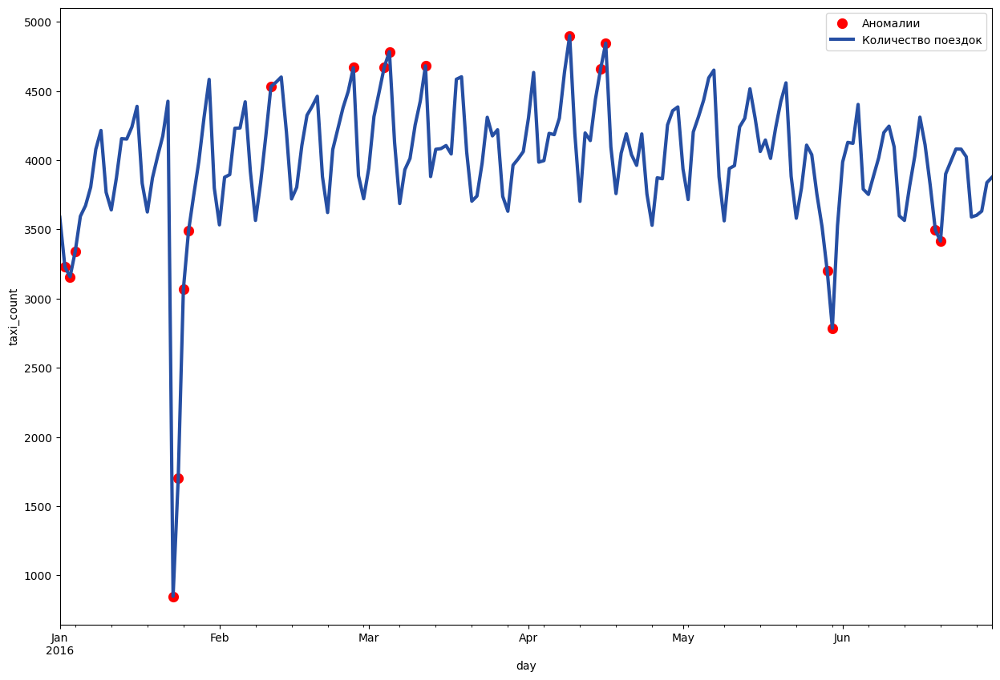

In [ ]:
clf = IsolationForest(n_estimators=500, max_samples='auto', contamination=float(0.1)).fit(weather_analisys[['taxi_count']] )
pred = clf.predict(weather_analisys[['taxi_count']])
weather_analisys['classification'] = pred
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()


df_out.loc[df_in.classification == 1,'taxi_count'] = np.NaN

fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot()


df_out.plot.scatter(x='day',y='taxi_count',ax=ax,c='red',label='Аномалии',linewidth=5.0)
df_in.plot(x='day',y='taxi_count',ax=ax, c='#264FA3',linewidth=3.0,label='Количество поездок')

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


<Axes: xlabel='day', ylabel='taxi_count'>

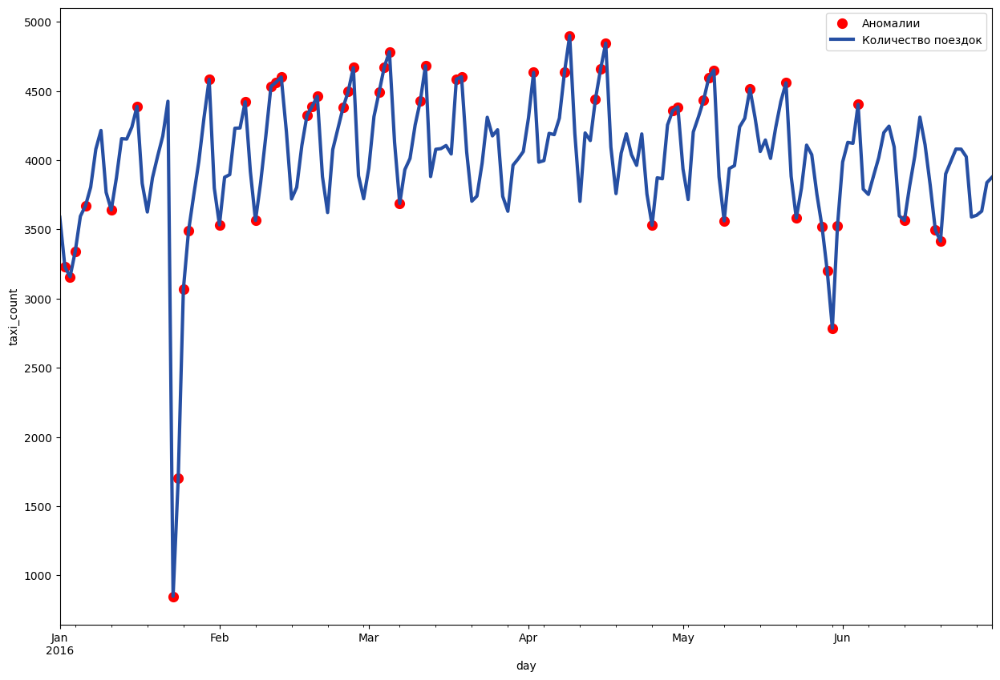

In [ ]:
clf = IsolationForest(n_estimators=150, max_samples='auto', contamination=float(0.3)).fit(weather_analisys[['taxi_count']] )
pred = clf.predict(weather_analisys[['taxi_count']])
weather_analisys['classification'] = pred
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()


df_out.loc[df_in.classification == 1,'taxi_count'] = np.NaN

fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot()


df_out.plot.scatter(x='day',y='taxi_count',ax=ax,c='red',label='Аномалии',linewidth=5.0)
df_in.plot(x='day',y='taxi_count',ax=ax, c='#264FA3',linewidth=3.0,label='Количество поездок')

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


<Axes: xlabel='day', ylabel='taxi_count'>

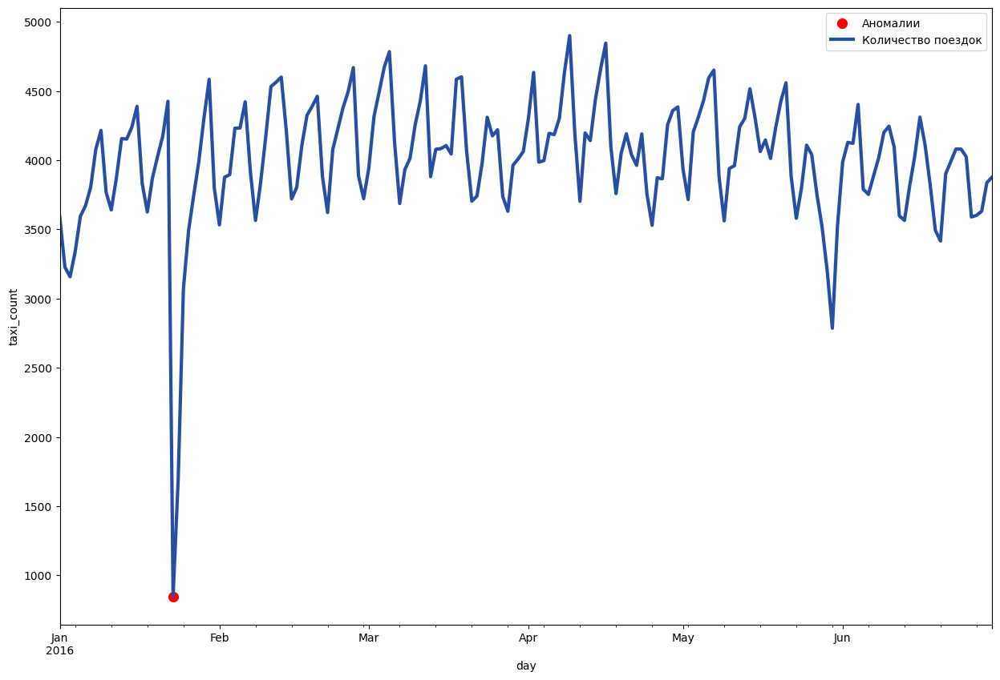

In [ ]:
clf = IsolationForest(n_estimators=150, max_samples='auto', contamination=float(0.001)).fit(weather_analisys[['taxi_count']] )
pred = clf.predict(weather_analisys[['taxi_count']])
weather_analisys['classification'] = pred
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()


df_out.loc[df_in.classification == 1,'taxi_count'] = np.NaN

fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot()


df_out.plot.scatter(x='day',y='taxi_count',ax=ax,c='red',label='Аномалии',linewidth=5.0)
df_in.plot(x='day',y='taxi_count',ax=ax, c='#264FA3',linewidth=3.0,label='Количество поездок')

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


<Axes: xlabel='day', ylabel='taxi_count'>

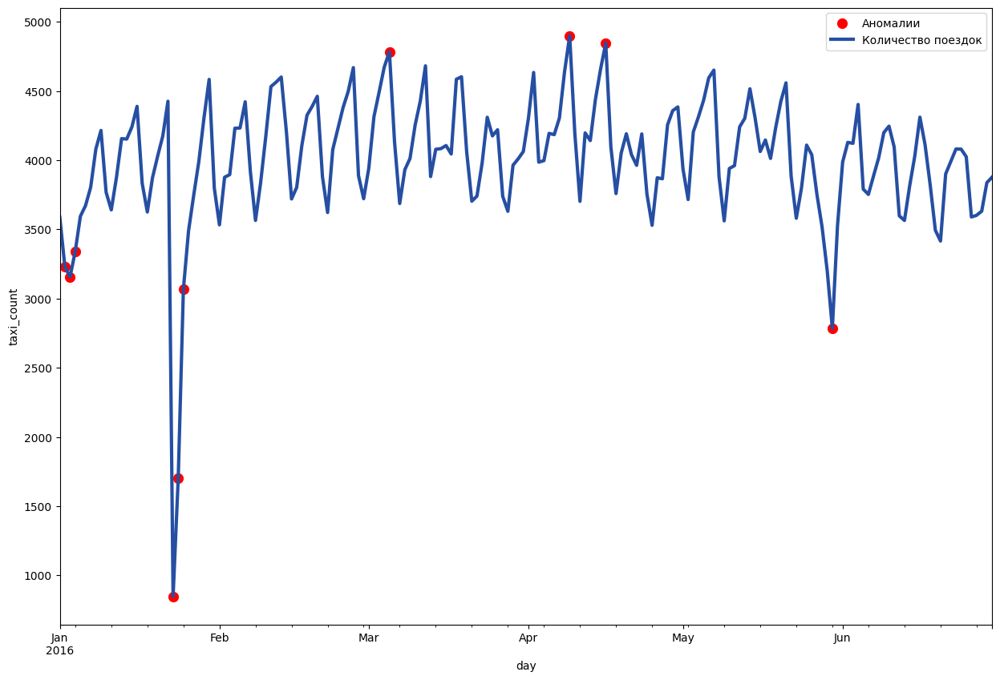

In [ ]:
clf = IsolationForest(n_estimators=150, max_samples='auto', contamination=float(0.05)).fit(weather_analisys[['taxi_count']] )
pred = clf.predict(weather_analisys[['taxi_count']])
weather_analisys['classification'] = pred
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()


df_out.loc[df_in.classification == 1,'taxi_count'] = np.NaN

fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot()


df_out.plot.scatter(x='day',y='taxi_count',ax=ax,c='red',label='Аномалии',linewidth=5.0)
df_in.plot(x='day',y='taxi_count',ax=ax, c='#264FA3',linewidth=3.0,label='Количество поездок')

In [ ]:
df_out.classification

0      1.0
1     -1.0
2     -1.0
3     -1.0
4      NaN
      ... 
177    NaN
178    NaN
179    NaN
180    NaN
181    1.0
Name: classification, Length: 182, dtype: float64

In [ ]:
c = np.concatenate([decomposition.seasonal.to_numpy(),weather_analisys['taxi_count'].to_numpy()])

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

#generate some fake data
x = np.random.random(10000)*10
y = np.random.random(10000)*10

col = np.where(x<1,'k',np.where(y<5,'b','r'))

plt.plot(x, y, c=col, s=5, linewidth=0)
plt.show()

# **Карты**

In [ ]:
pickup_longitude = trip_duration[['id', 'pickup_longitude']].rename(columns={'pickup_longitude': 'longitude'})
pickup_longitude['type'] = 'pickup'
dropoff_longitude = trip_duration[['id', 'dropoff_longitude']].rename(columns={'dropoff_longitude': 'longitude'})
dropoff_longitude['type'] = 'dropoff'

longitudes = pd.concat((pickup_longitude, dropoff_longitude))

pickup_latitude = trip_duration[['id', 'pickup_latitude']].rename(columns={'pickup_latitude': 'latitude'})
pickup_latitude['type'] = 'pickup'
dropoff_latitude = trip_duration[['id', 'dropoff_latitude']].rename(columns={'dropoff_latitude': 'latitude'})
dropoff_latitude['type'] = 'dropoff'

latitudes = pd.concat((pickup_latitude, dropoff_latitude))

coords = pd.merge(longitudes, latitudes, on=['id', 'type'])

In [ ]:
with open('/content/gdrive/MyDrive/intensive/Project/NYC Taxi Zones.geojson') as f:
    taxi_zones = json.load(f)

fig = px.scatter_mapbox(coords.iloc[1000000:,:], lat='latitude', lon='longitude', hover_name='type')
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(mapbox_bounds={"west": -180, "east": -50, "south": 20, "north": 90})
fig.update_traces(cluster=dict(enabled=True))
fig.update_layout(
    mapbox = {
        'style': "open-street-map",
        'center': { 'lon': -73.9662, 'lat': 40.7834},
        'zoom': 9, 'layers': [{
            'source': taxi_zones,
            'type': "fill", 'below': "traces", 'color': "gray", 'name': 'Область работы такси',
        'opacity': 0.5}]},
    margin = {'l':0, 'r':0, 'b':0, 't':0})
fig.show()

In [ ]:
coords

,id,longitude,type,latitude
0,id3888279,-73.982292,pickup,40.751331
1,id0924227,-73.970108,pickup,40.759800
2,id2914314,-73.985443,pickup,40.735710
3,id3968582,-73.993973,pickup,40.740868
4,id2563820,-73.959511,pickup,40.762810
...,...,...,...,...
1449205,id3674376,-73.911179,dropoff,40.767735
1449206,id1785039,-73.950737,dropoff,40.693722
1449207,id3012598,-73.988182,dropoff,40.769695
1449208,id0376262,-73.926704,dropoff,40.856739


In [ ]:
import folium
from folium import plugins
from IPython.display import HTML, display,IFrame
mymap = folium.Map(location=[41., -74], zoom_start=8 )

#for lat, lon in zip(test['pickup_latitude'],test['pickup_longitude']):
#    folium.CircleMarker([lat, lon],radius=4, color='black',
#                    fill_color='red', fill_opacity=0.5, opacity=0.4).add_to(map)
#map

taxi = coords.loc[:,('longitude', 'latitude')].values

# plot heatmap
mymap.add_child(plugins.HeatMap(taxi, radius=15))
mymap.save('plot_data.html')
IFrame('plot_data.html', width=700, height=350)

# **Prophet**

In [ ]:
!pip install prophet

In [ ]:
from prophet import Prophet

m = Prophet()
df = weather_analisys[['day','taxi_count']]
df.columns = ['ds','y']
m.fit(df)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpa1j7f5la/z8jrnxom.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpa1j7f5la/6d40cr3s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63069', 'data', 'file=/tmp/tmpa1j7f5la/z8jrnxom.json', 'init=/tmp/tmpa1j7f5la/6d40cr3s.json', 'output', 'file=/tmp/tmpa1j7f5la/prophet_model8gf0cmg_/prophet_model-20230420204226.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:42:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:42:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


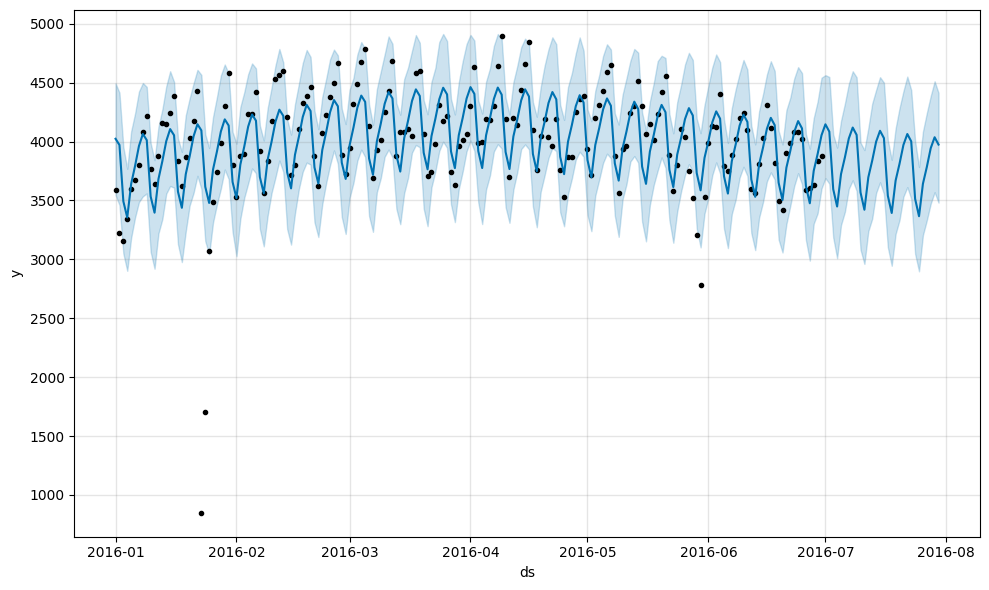

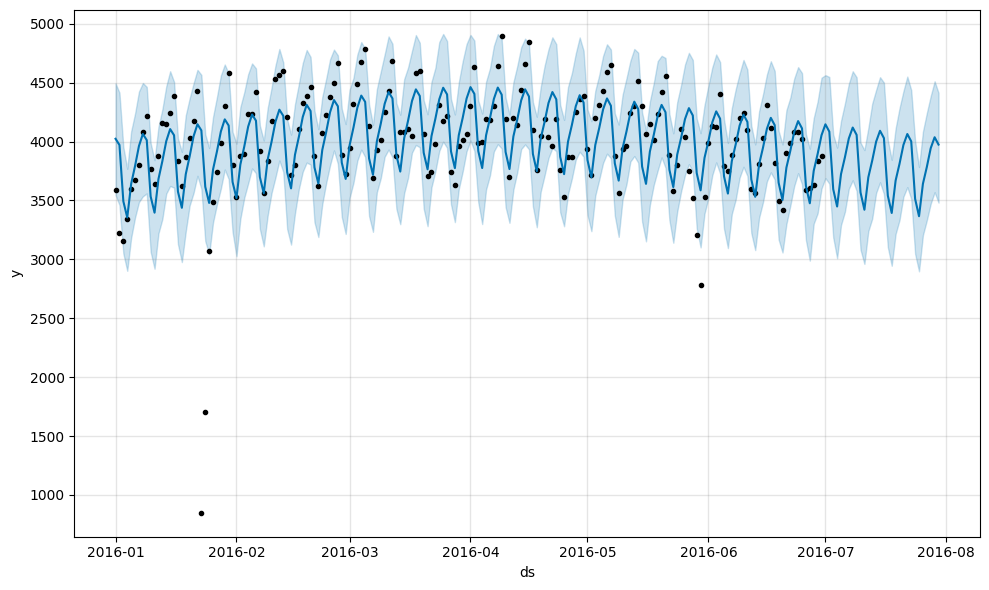

In [ ]:
future = m.make_future_dataframe(periods=30)
forecast = m.predict(future)
m.plot(forecast)

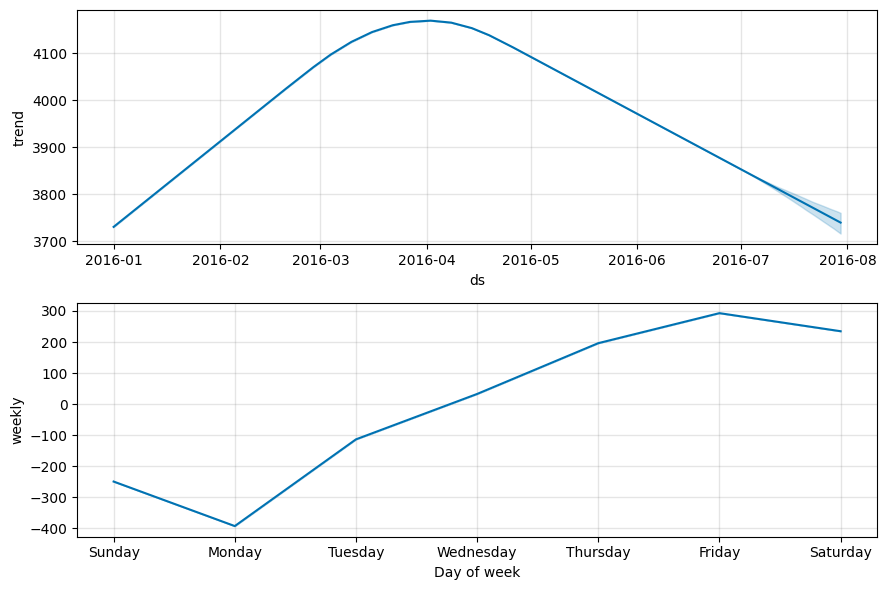

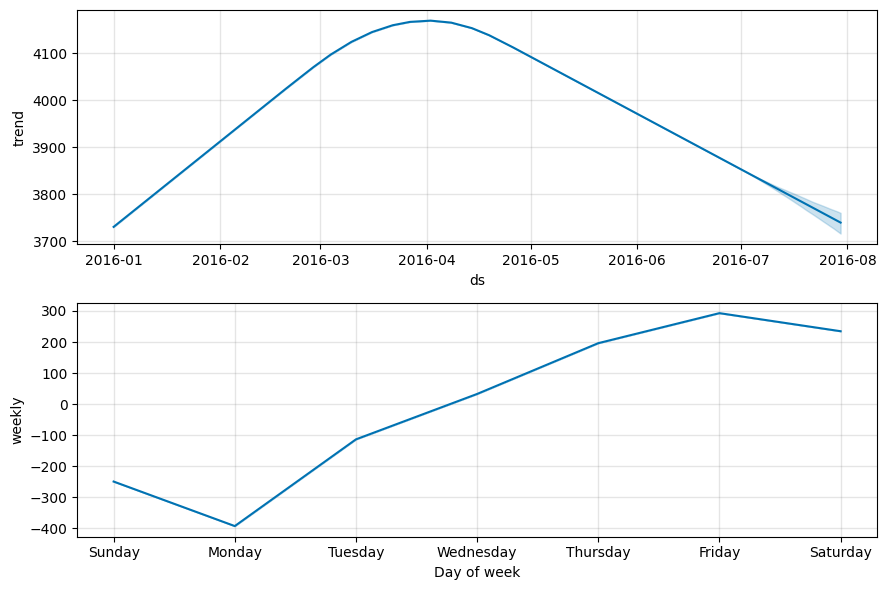

In [ ]:
m.plot_components(forecast)

In [ ]:
from sklearn.metrics import mean_absolute_error,mean_absolute_percentage_error


performance = pd.merge(df, forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']], on='ds')

performance_MAE = mean_absolute_error(performance['y'], performance['yhat'])
print(f'The MAE for the model is {performance_MAE}')

performance_MAPE = mean_squared_error(performance['y'], performance['yhat'])
print(f'The MAPE for the model is {performance_MAPE}')

The MAE for the model is 197.08738190257756
The MAPE for the model is 127898.21557059427


In [ ]:
classific

,ds,y,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2016-01-01,3588,3730.835500,3564.886432,4467.720967,3730.835500,3730.835500,292.993989,292.993989,292.993989,292.993989,292.993989,292.993989,0.0,0.0,0.0,4023.829489
1,2016-01-02,3228,3736.725354,3510.193691,4425.428386,3736.725354,3736.725354,234.747363,234.747363,234.747363,234.747363,234.747363,234.747363,0.0,0.0,0.0,3971.472717
2,2016-01-03,3158,3742.615208,2995.509154,3940.885338,3742.615208,3742.615208,-249.680803,-249.680803,-249.680803,-249.680803,-249.680803,-249.680803,0.0,0.0,0.0,3492.934405
3,2016-01-04,3341,3748.505062,2901.776066,3831.000730,3748.505062,3748.505062,-393.167571,-393.167571,-393.167571,-393.167571,-393.167571,-393.167571,0.0,0.0,0.0,3355.337492
4,2016-01-05,3595,3754.394917,3202.795317,4091.300995,3754.394917,3754.394917,-113.725241,-113.725241,-113.725241,-113.725241,-113.725241,-113.725241,0.0,0.0,0.0,3640.669676
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177,2016-06-26,3590,3873.382083,3168.769473,4050.994682,3873.382083,3873.382083,-249.680803,-249.680803,-249.680803,-249.680803,-249.680803,-249.680803,0.0,0.0,0.0,3623.701280
178,2016-06-27,3602,3869.458628,3013.483031,3948.999892,3869.458628,3869.458628,-393.167571,-393.167571,-393.167571,-393.167571,-393.167571,-393.167571,0.0,0.0,0.0,3476.291057
179,2016-06-28,3632,3865.535172,3308.244069,4205.221451,3865.535172,3865.535172,-113.725241,-113.725241,-113.725241,-113.725241,-113.725241,-113.725241,0.0,0.0,0.0,3751.809931
180,2016-06-29,3838,3861.611717,3400.366824,4327.403602,3861.611717,3861.611717,32.584225,32.584225,32.584225,32.584225,32.584225,32.584225,0.0,0.0,0.0,3894.195942


<Axes: xlabel='ds', ylabel='y'>

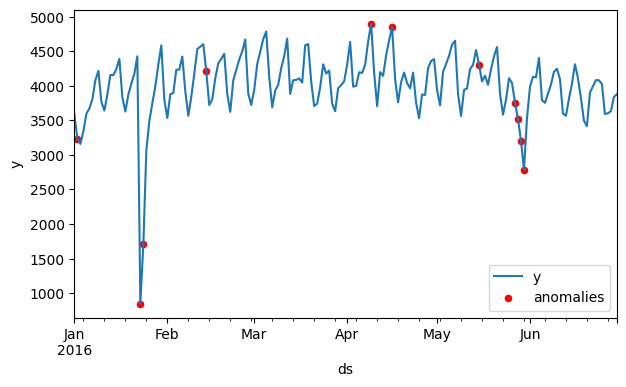

In [ ]:
preds = m.predict(df)
classific = df.merge(preds, how='inner', on='ds')

ex = classific[(classific.y <= classific.yhat_lower) | (classific.y >= classific.yhat_upper)]

fig = plt.figure(figsize=(7,4))
ax = fig.add_subplot()

classific.plot(x='ds',y='y',ax=ax)
ex.plot.scatter(x='ds',y='y',c='red',label='anomalies',ax=ax)

In [ ]:
def Anomalies(df,group,metric,func):

      data = trip_duration.groupby(group,as_index=False).agg({metric: func})
      df = data[[group,metric ]]
      df.columns = ['ds','y']

      m = Prophet()
      m.fit(df)
      preds = m.predict(df)

      classific= pd.merge(df, preds[['ds', 'yhat', 'yhat_lower', 'yhat_upper']], on='ds')
      classific['anomaly'] = classific.apply(lambda rows: 1 if ((rows.y <= rows.yhat_lower)|(rows.y >= rows.yhat_upper)) else 0, axis = 1)

      anomalies = performance[classific['anomaly'] == 1].sort_values(by='ds')


      return anomalies, classific

      sns.scatterplot(x='ds', y='y', data=classific, hue='anomaly')
      sns.lineplot(x='ds', y='yhat', data=classific, color='black')


<Axes: title={'center': 'Количество поездок'}, xlabel='Дата', ylabel='Количество поездок'>

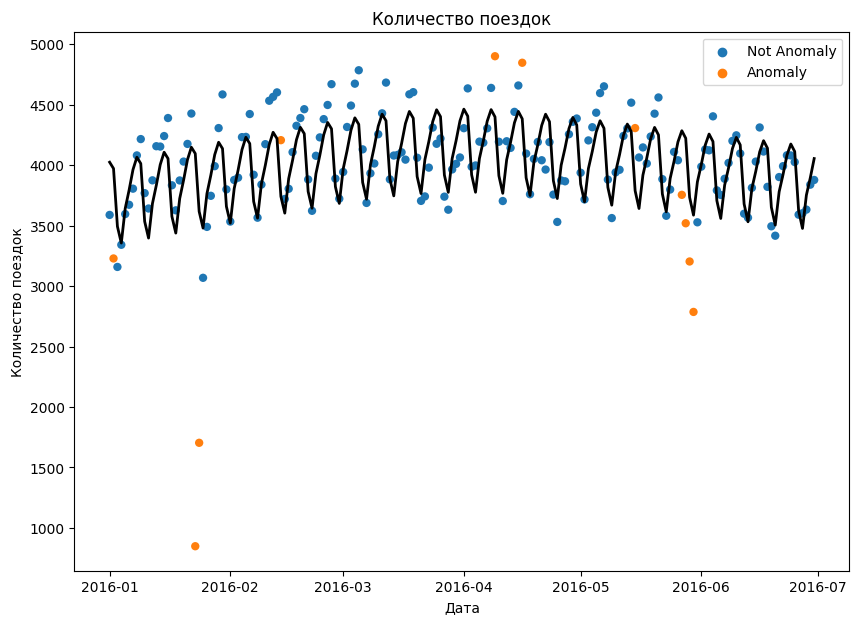

In [ ]:
classific= pd.merge(df, preds[['ds', 'yhat', 'yhat_lower', 'yhat_upper']], on='ds')
classific['anomaly'] = classific.apply(lambda rows: 'Anomaly' if ((rows.y<=rows.yhat_lower)|(rows.y>=rows.yhat_upper)) else 'Not Anomaly', axis = 1)

anomalies = classific[classific['anomaly']==1 ].sort_values(by='ds')
fig = plt.figure(figsize=(10,7))
sns.scatterplot(x='ds', y='y', data=classific, hue='anomaly',linewidth = 0.001).set(title='Количество поездок',ylabel='Количество поездок',xlabel='Дата')
sns.lineplot(x='ds', y='yhat', data=classific, color='black',linewidth = 2)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpsfslqizv/qwg1lc54.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpsfslqizv/s5tno29y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2618', 'data', 'file=/tmp/tmpsfslqizv/qwg1lc54.json', 'init=/tmp/tmpsfslqizv/s5tno29y.json', 'output', 'file=/tmp/tmpsfslqizv/prophet_modelqcckg7td/prophet_model-20230415223459.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
22:34:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
22:34:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonality.

<Axes: xlabel='ds', ylabel='y'>

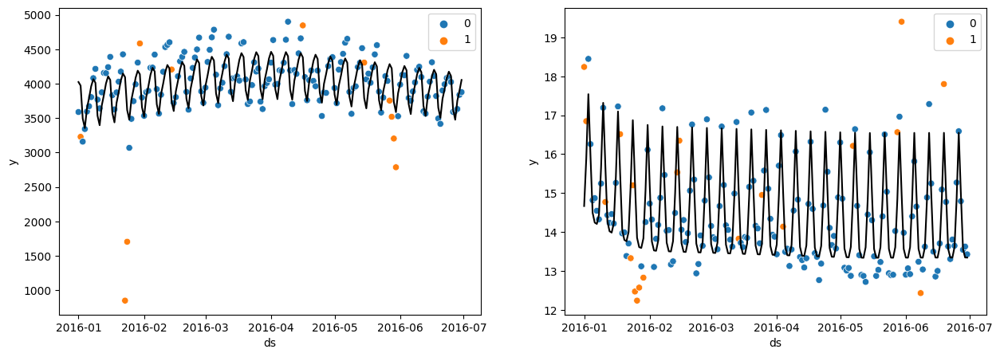

In [ ]:

fig = plt.figure(figsize=(15,5))
ax = fig.subplots(1,2)

anomalies, classific = Anomalies(trip_duration,'day',"id",'count')

sns.scatterplot(x='ds', y='y', data=classific, hue='anomaly',ax=ax[0])
sns.lineplot(x='ds', y='yhat', data=classific, color='black',ax=ax[0])


anomalies, classific = Anomalies(trip_duration,'day','avg_speed',"mean")

sns.scatterplot(x='ds', y='y', data=classific, hue='anomaly',ax=ax[1])
sns.lineplot(x='ds', y='yhat', data=classific, color='black',ax=ax[1])